# Time series analysis

A company wants to analyze some bodies of water, primarily focusing on one of the existing models.

# Load the data

In [1]:
# import the libraries to use
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme()

In [2]:
df = pd.read_csv("../data/Aquifer_Petrignano.csv")

In [3]:
df.head()

,Date,Rainfall_Bastia_Umbra,Depth_to_Groundwater_P24,Depth_to_Groundwater_P25,Temperature_Bastia_Umbra,Temperature_Petrignano,Volume_C10_Petrignano,Hydrometry_Fiume_Chiascio_Petrignano
0,14/03/2006,NaN,-22.48,-22.18,NaN,NaN,NaN,NaN
1,15/03/2006,NaN,-22.38,-22.14,NaN,NaN,NaN,NaN
2,16/03/2006,NaN,-22.25,-22.04,NaN,NaN,NaN,NaN
3,17/03/2006,NaN,-22.38,-22.04,NaN,NaN,NaN,NaN
4,18/03/2006,NaN,-22.60,-22.04,NaN,NaN,NaN,NaN


We are going to work with just one of the depth to predict

In [4]:
# based on recommendations, we delete old columns
df = df[df.Rainfall_Bastia_Umbra.notna()].reset_index(drop=True)
# based on recommendations, we are going to remove the following columns
# in this case we are going just to predict one of the depths
# we can create a multi regressor or a NN to do the prediction of the multy depths
df = df.drop(['Depth_to_Groundwater_P24', 'Temperature_Petrignano'], axis=1)

Simplify column names

In [5]:
# simplify column names
df.columns = ['date', 'rainfall', 'depth_to_groundwater', 'temperature', 'drainage_volume', 'river_hydrometry']

targets = ['depth_to_groundwater']
features = [feature for feature in df.columns if feature not in targets]
df.head()

,date,rainfall,depth_to_groundwater,temperature,drainage_volume,river_hydrometry
0,1/1/2009,0.0,-31.14,5.2,-24530.688,2.4
1,2/1/2009,0.0,-31.11,2.3,-28785.888,2.5
2,3/1/2009,0.0,-31.07,4.4,-25766.208,2.4
3,4/1/2009,0.0,-31.05,0.8,-27919.296,2.4
4,5/1/2009,0.0,-31.01,-1.9,-29854.656,2.3


## Transform the date column to datetime type

In [6]:
df['date'] = pd.to_datetime(df['date'], format = '%d/%m/%Y')

In [7]:
df.head()

,date,rainfall,depth_to_groundwater,temperature,drainage_volume,river_hydrometry
0,2009-01-01,0.0,-31.14,5.2,-24530.688,2.4
1,2009-01-02,0.0,-31.11,2.3,-28785.888,2.5
2,2009-01-03,0.0,-31.07,4.4,-25766.208,2.4
3,2009-01-04,0.0,-31.05,0.8,-27919.296,2.4
4,2009-01-05,0.0,-31.01,-1.9,-29854.656,2.3


In [8]:
min_year = df["date"].min()
max_year = df["date"].max()

print(f'Min date: {min_year}')
print(f'Max date: {max_year}')

Min date: 2009-01-01 00:00:00
Max date: 2020-06-30 00:00:00


Let's verify if the dates are month a month for 11 years

In [9]:
import plotly.tools as tls


fig, axis = plt.subplots(figsize = (18, 6))

sns.histplot(data=df, x='date', bins=12)

# convert the seaborn figure to Plotly figure
plotly_fig = tls.mpl_to_plotly(fig)

plotly_fig.show()

In [10]:
import plotly.express as px

p_graph = px.histogram(
    df,
    x='date',
    title='Histogram of the dates with Plotly (bins have errors)',
    template='plotly_dark',
)

p_graph.show()

We can see that the dates are from 2009-01-01 to 2020-06-01 and the length of the df is 138 (138 months).

## Handle missing values

Let's see the missing values.

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4199 entries, 0 to 4198
Data columns (total 6 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   date                  4199 non-null   datetime64[ns]
 1   rainfall              4199 non-null   float64       
 2   depth_to_groundwater  4172 non-null   float64       
 3   temperature           4199 non-null   float64       
 4   drainage_volume       4198 non-null   float64       
 5   river_hydrometry      4199 non-null   float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 197.0 KB


(14245.0, 18443.0)

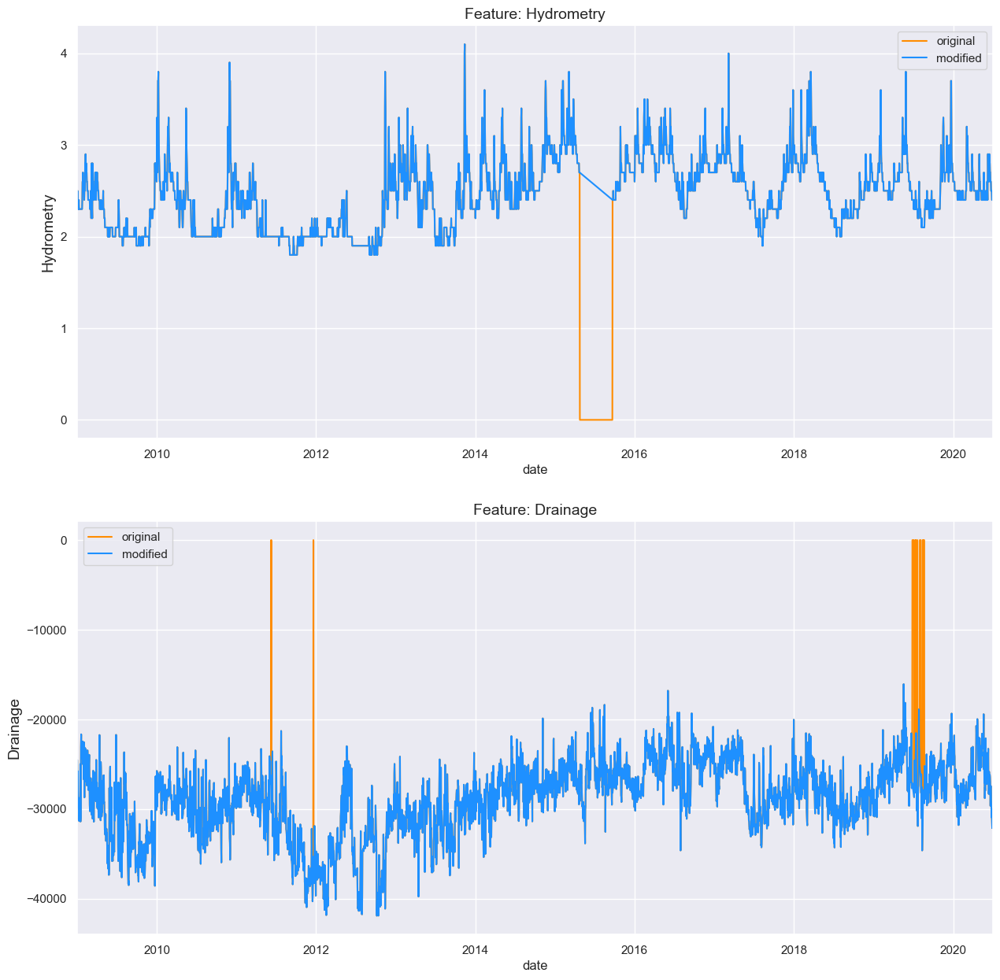

In [12]:
from datetime import date

f, ax = plt.subplots(nrows=2, ncols=1, figsize=(15, 15))

# replace the values
old_hydrometry = df['river_hydrometry'].copy()
df['river_hydrometry'] = df['river_hydrometry'].replace(0, np.nan)

sns.lineplot(x=df['date'], y=old_hydrometry, ax=ax[0], color='darkorange', label='original')
sns.lineplot(x=df['date'], y=df['river_hydrometry'].fillna(np.inf), ax=ax[0], color='dodgerblue', label='modified')
ax[0].set_title('Feature: Hydrometry', fontsize=14)
ax[0].set_ylabel(ylabel='Hydrometry', fontsize=14)
ax[0].set_xlim([date(2009, 1, 1), date(2020, 6, 30)])

# replace the values
old_drainage = df['drainage_volume'].copy()
df['drainage_volume'] = df['drainage_volume'].replace(0, np.nan)

sns.lineplot(x=df['date'], y=old_drainage, ax=ax[1], color='darkorange', label='original')
sns.lineplot(x=df['date'], y=df['drainage_volume'].fillna(np.inf), ax=ax[1], color='dodgerblue', label='modified')
ax[1].set_title('Feature: Drainage', fontsize=14)
ax[1].set_ylabel(ylabel='Drainage', fontsize=14)
ax[1].set_xlim([date(2009, 1, 1), date(2020, 6, 30)])

In [13]:
df.isna().count()

date                    4199
rainfall                4199
depth_to_groundwater    4199
temperature             4199
drainage_volume         4199
river_hydrometry        4199
dtype: int64

We can see we have lots of missing values. We can handle them with some of the followign strategies

Missing Values, how to handle

- **Option 1: Fill NaN with an Outlier or Zero**

In this specific example filling the missing value with an outlier value such as `np.inf` or 0 seems to be very naive. However, using values like `-999`, is sometimes a good idea.

- **Option 2: Fill NaN with Mean Value**

Filling NaNs with the mean value is also not sufficient and naive, and doesn't seems to be a good option.

- **Option 3: Fill NaN with Last Value with .ffill()**

Filling NaNs with the last value could be bit better.

- **Option 4: Fill NaN with Linearly Interpolated Value with .interpolate()**

Filling NaNs with the interpolated values is the best option in this small example, but it requires knowledge of the neighboring value

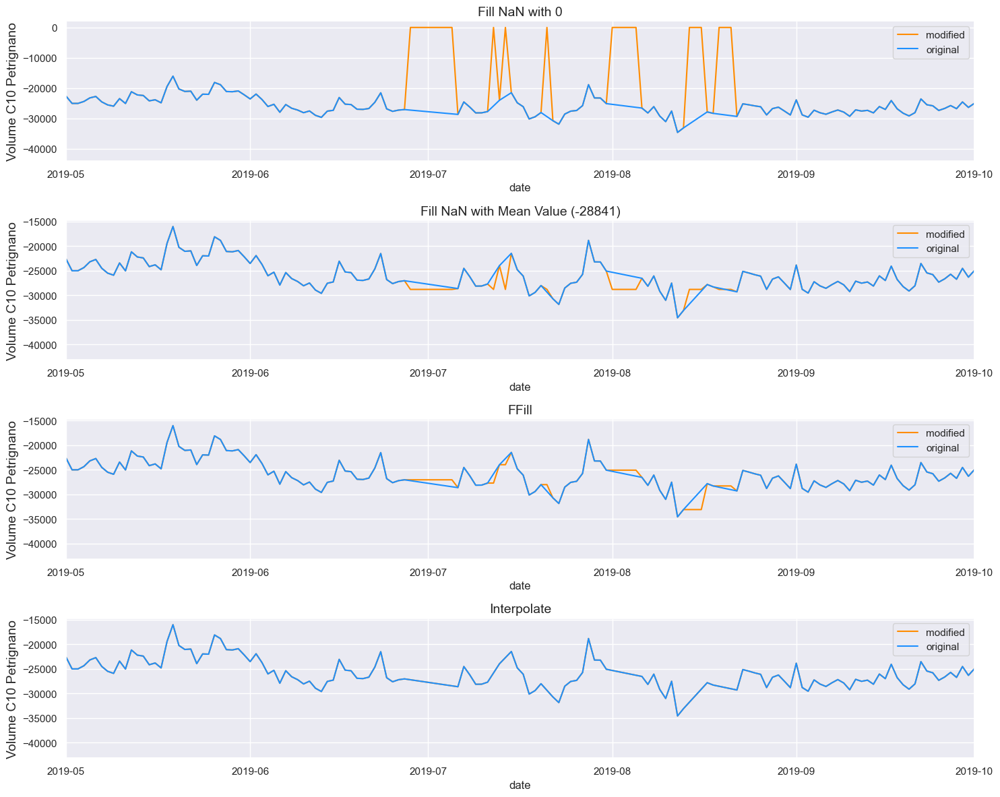

In [14]:
f, ax = plt.subplots(nrows=4, ncols=1, figsize=(15, 12))

sns.lineplot(x=df['date'], y=df['drainage_volume'].fillna(0), ax=ax[0], color='darkorange', label = 'modified')
sns.lineplot(x=df['date'], y=df['drainage_volume'].fillna(np.inf), ax=ax[0], color='dodgerblue', label = 'original')
ax[0].set_title('Fill NaN with 0', fontsize=14)
ax[0].set_ylabel(ylabel='Volume C10 Petrignano', fontsize=14)

mean_drainage = df['drainage_volume'].mean()
sns.lineplot(x=df['date'], y=df['drainage_volume'].fillna(mean_drainage), ax=ax[1], color='darkorange', label = 'modified')
sns.lineplot(x=df['date'], y=df['drainage_volume'].fillna(np.inf), ax=ax[1], color='dodgerblue', label = 'original')
ax[1].set_title(f'Fill NaN with Mean Value ({mean_drainage:.0f})', fontsize=14)
ax[1].set_ylabel(ylabel='Volume C10 Petrignano', fontsize=14)

sns.lineplot(x=df['date'], y=df['drainage_volume'].ffill(), ax=ax[2], color='darkorange', label = 'modified')
sns.lineplot(x=df['date'], y=df['drainage_volume'].fillna(np.inf), ax=ax[2], color='dodgerblue', label = 'original')
ax[2].set_title(f'FFill', fontsize=14)
ax[2].set_ylabel(ylabel='Volume C10 Petrignano', fontsize=14)

sns.lineplot(x=df['date'], y=df['drainage_volume'].interpolate(), ax=ax[3], color='darkorange', label = 'modified')
sns.lineplot(x=df['date'], y=df['drainage_volume'].fillna(np.inf), ax=ax[3], color='dodgerblue', label = 'original')
ax[3].set_title(f'Interpolate', fontsize=14)
ax[3].set_ylabel(ylabel='Volume C10 Petrignano', fontsize=14)

for i in range(4):
    ax[i].set_xlim([date(2019, 5, 1), date(2019, 10, 1)])

plt.tight_layout()
plt.show()

As we can see, the last option is the best in this case. Let's do the interpolation.

In [15]:
df['drainage_volume'] = df['drainage_volume'].interpolate()
df['river_hydrometry'] = df['river_hydrometry'].interpolate()
df['depth_to_groundwater'] = df['depth_to_groundwater'].interpolate()

## Smoothing data / Resampling

Resampling can provide additional information on the data. There are two types of resampling:

* **Upsampling** is when the frequency of samples is increased (e.g. days to hours)
* **Downsampling** is when the frequency of samples is decreased (e.g. days to weeks)

We will do some downsampling with `.resample()`.

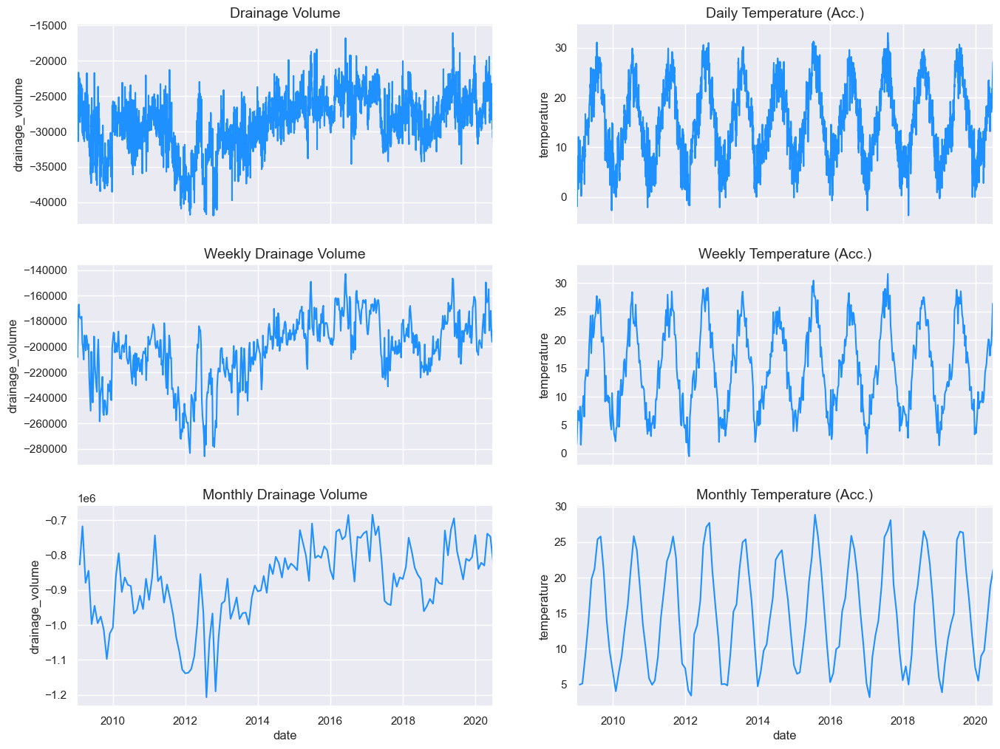

In [16]:
fig, ax = plt.subplots(ncols=2, nrows=3, sharex=True, figsize=(16,12))

# first graph
sns.lineplot(x=df['date'], y=df['drainage_volume'], color='dodgerblue', ax=ax[0, 0])
ax[0, 0].set_title('Drainage Volume', fontsize=14)

# second graph with resample
resampled_df = df[['date','drainage_volume']].resample('7D', on='date').sum().reset_index(drop=False)
sns.lineplot(x=resampled_df['date'], y=resampled_df['drainage_volume'], color='dodgerblue', ax=ax[1, 0])
ax[1, 0].set_title('Weekly Drainage Volume', fontsize=14)

# third graph with resample
resampled_df = df[['date','drainage_volume']].resample('ME', on='date').sum().reset_index(drop=False)
sns.lineplot(x=resampled_df['date'], y=resampled_df['drainage_volume'], color='dodgerblue', ax=ax[2, 0])
ax[2, 0].set_title('Monthly Drainage Volume', fontsize=14)

for i in range(3):
    ax[i, 0].set_xlim([date(2009, 1, 1), date(2020, 6, 30)])

# forth graph
sns.lineplot(x=df['date'], y=df['temperature'], color='dodgerblue', ax=ax[0, 1])
ax[0, 1].set_title('Daily Temperature (Acc.)', fontsize=14)

# fifth graph with resample
resampled_df = df[['date','temperature']].resample('7D', on='date').mean().reset_index(drop=False)
sns.lineplot(x=resampled_df['date'], y=resampled_df['temperature'], color='dodgerblue', ax=ax[1, 1])
ax[1, 1].set_title('Weekly Temperature (Acc.)', fontsize=14)

# sixth graph with resample
resampled_df = df[['date','temperature']].resample('ME', on='date').mean().reset_index(drop=False)
sns.lineplot(x=resampled_df['date'], y=resampled_df['temperature'], color='dodgerblue', ax=ax[2, 1])
ax[2, 1].set_title('Monthly Temperature (Acc.)', fontsize=14)

for i in range(3):
    ax[i, 1].set_xlim([date(2009, 1, 1), date(2020, 6, 30)])
plt.show()

In [17]:
# downsample to weekly could smooth the data and help with analysis
downsample = df[['date',
                 'depth_to_groundwater',
                 'temperature',
                 'drainage_volume',
                 'river_hydrometry',
                 'rainfall'
                ]].resample('7D', on='date').mean().reset_index(drop=False)

df = downsample.copy()

# See the time series

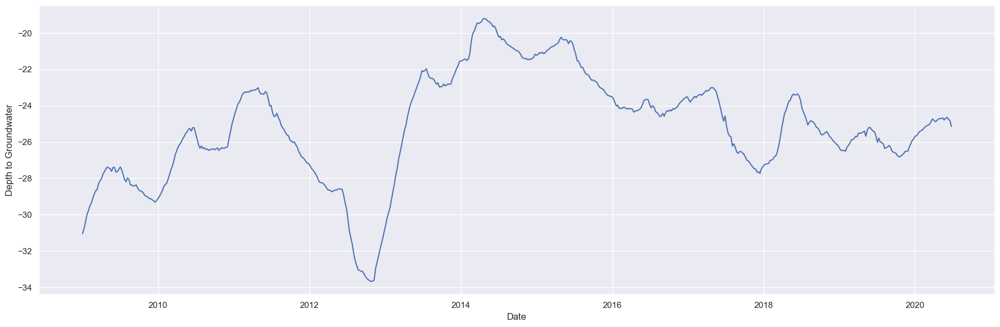

In [18]:
fig, axis = plt.subplots(figsize = (18, 6))

sns.lineplot(data=df, x='date', y='depth_to_groundwater')

plt.tight_layout()
plt.xlabel('Date')
plt.ylabel('Depth to Groundwater')

plt.show()

# Create the time series for the depth

In [19]:
# set the index of the dataframe to the date
ts_aux = df.set_index('date')

# create the time series
ts = ts_aux['depth_to_groundwater']

ts.head()

date
2009-01-01   -31.048571
2009-01-08   -30.784286
2009-01-15   -30.420000
2009-01-22   -30.018571
2009-01-29   -29.790000
Name: depth_to_groundwater, dtype: float64

## Get one year of data to also analyze granularly

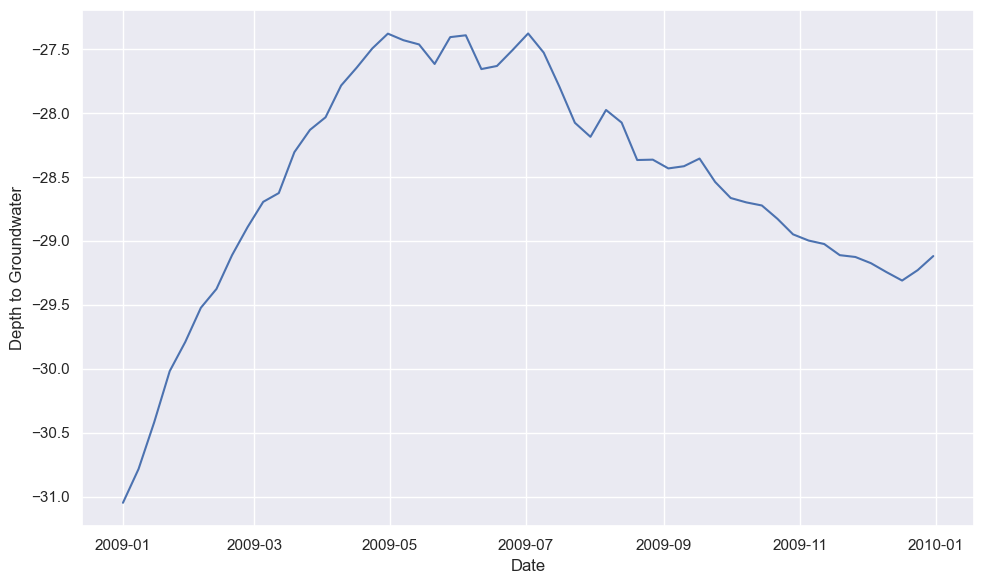

In [20]:
# create the sub df of just one month
down_limit = pd.to_datetime('2009-01-01')
up_limit = pd.to_datetime('2010-01-01')

sub_df = df[(df['date'] >= down_limit) & (df['date'] <= up_limit)]

# graph the data
fig, axis = plt.subplots(figsize=(10, 6))

sns.lineplot(data=sub_df, x='date', y='depth_to_groundwater')

plt.tight_layout()
plt.xlabel('Date')
plt.ylabel('Depth to Groundwater')

plt.show()

In [21]:
# set the index of the dataframe to the date
sub_ts_aux = sub_df.set_index('date')

# create the time series
sub_ts = sub_ts_aux['depth_to_groundwater']

ts.head()

date
2009-01-01   -31.048571
2009-01-08   -30.784286
2009-01-15   -30.420000
2009-01-22   -30.018571
2009-01-29   -29.790000
Name: depth_to_groundwater, dtype: float64

# Analysis of the time series

We are going to study the following of the time serires:

- Tensor of the time series
- Trend
- If its stationary
- Variability or noise

## Descomposition of the series

In [22]:
from statsmodels.tsa.seasonal import seasonal_decompose

# decomposition with period 12 to be monthly
decomposition = seasonal_decompose(ts, period = 12)
decomposition

## Tensor of the time series

In [23]:
# the tensor represents the minimum time observation
tensor = ts.index.to_series().diff().mode()[0]
print('Tensor:', tensor)

Tensor: 7 days 00:00:00


The data is weekly thanks to the resampling, so the tensor is of 7 days. This means that the time series is a weekly.

## Trend

A trend refers to the general direction in which the data is moving.

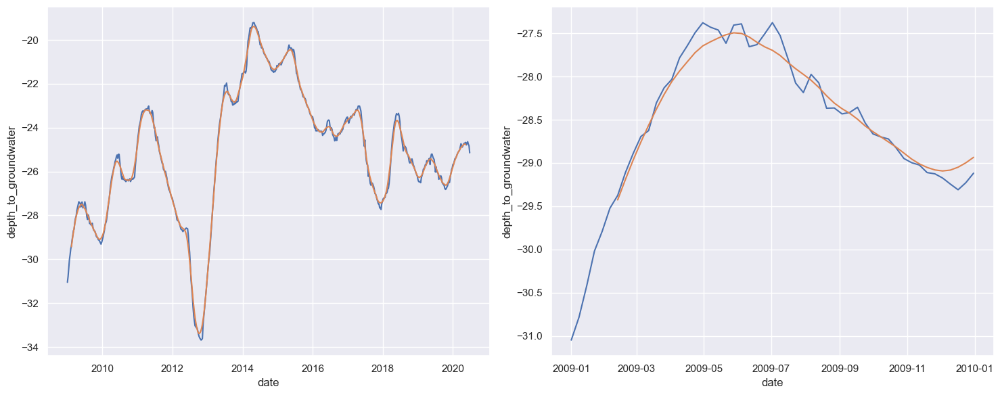

In [24]:
# get the trend of the decomposition
trend = decomposition.trend
sub_trend = trend[down_limit:up_limit]

fig, axis = plt.subplots(1, 2, figsize = (15, 6))

# first fig
sns.lineplot(ax=axis[0], data=ts)
sns.lineplot(ax=axis[0], data=trend)

# second fig
sns.lineplot(ax=axis[1], data=sub_ts)
sns.lineplot(ax=axis[1], data=sub_trend)

plt.tight_layout()

plt.show()

We can see that this time series has a lot of variance.

## Seasonality analysis

Seasonality refers to repetitive patterns in the data.

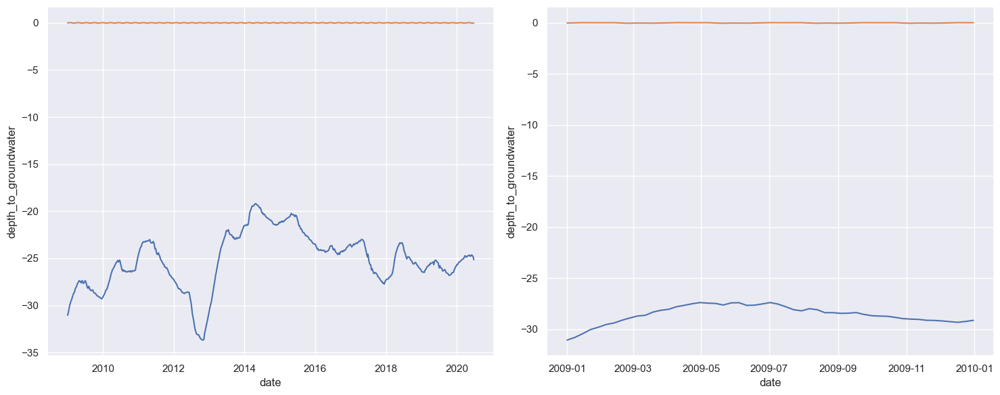

In [25]:
# get the seasonality of the decomposition
seasonal = decomposition.seasonal
sub_seasonal = seasonal[down_limit:up_limit]

fig, axis = plt.subplots(1, 2, figsize = (15, 6))

# first fig
sns.lineplot(ax=axis[0], data=ts)
sns.lineplot(ax=axis[0], data=seasonal)

# second fig
sns.lineplot(ax=axis[1], data=sub_ts)
sns.lineplot(ax=axis[1], data=sub_seasonal)

plt.tight_layout()

plt.show()

We can see in the graph of just one year that it increases its values until approximate May and then starts to decrease.

We can see just the seasonality of the time series.

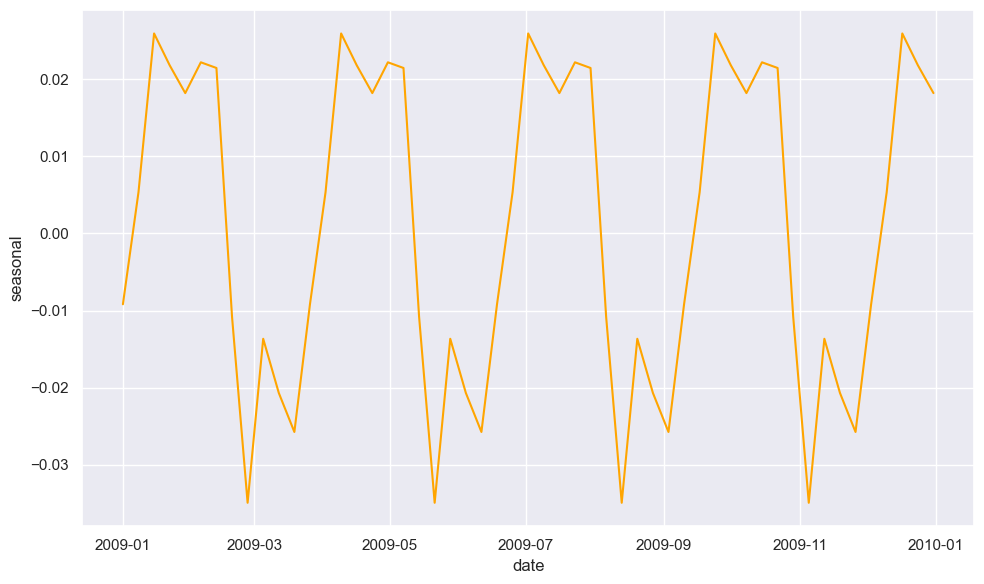

In [26]:
fig, axis = plt.subplots(figsize = (10, 6))


sns.lineplot(data=sub_seasonal, color='orange')
plt.tight_layout()
plt.show()

Studying the seasonality in close, we can see that contrary to what we saw in the previous graph, patterns repeat themselves every 2 months. And the differences in the **depth** are in the range of -0.03 to 0.03 approximately.

## Stationarity

To evaluate the stationarity of the time series, we are going to use the Dickey-Fuller test, which is a hypothesis test in which:
- The null hypothesis is that the series is not stationary.
- The alternative is that it is stationary.

In [27]:
from statsmodels.tsa.stattools import adfuller


def test_stationarity(time_series: pd.Series):
    """
    Perform the Dickey-Fuller test on the time series data.

    Args:
        time_series (pd.Series): The time series data to test.

    Returns:
        pd.Series: A series containing the test statistic, p-value, number of lags used, number of observations used,
                   and critical values for the test.
    """

    # perform the Dickey-Fuller test
    df_test = adfuller(time_series, autolag = "AIC")

    # create a panda's series to store the results
    df_output = pd.Series(df_test[0:4], index = ["Test Statistic", "p-value", "#Lags Used", "Number of Observations Used"])

    # add the critical values to the series
    for key,value in df_test[4].items():
        df_output["Critical Value (%s)" % key] = value

    return df_output

In [28]:
# perform the test
test_stationarity(time_series=ts)

Test Statistic                  -2.880202
p-value                          0.047699
#Lags Used                       7.000000
Number of Observations Used    592.000000
Critical Value (1%)             -3.441444
Critical Value (5%)             -2.866435
Critical Value (10%)            -2.569377
dtype: float64

Conclusion:

Based on the p-value and the comparison with the critical values:

- At the 5% and 10% significance levels, we can reject the null hypothesis. This means that there is enough statistical evidence to conclude that the time series is stationary at these significance levels.
- At the 1% significance level, we cannot reject the null hypothesis. This means that, using a more stringent criterion, there is not enough evidence to conclude that the series is stationary.

## Analysis of variability

Variability involves the study of residuals: that is how the data fluctuate once trend and seasonality have been studied.

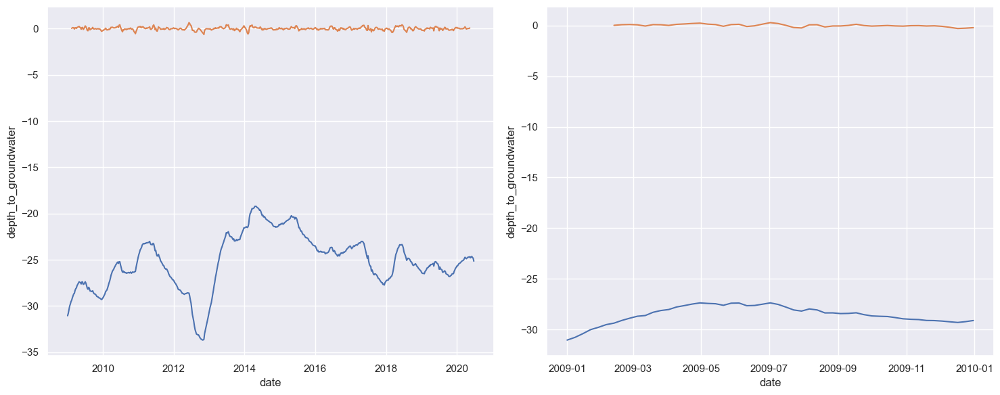

In [29]:
# get the seasonality of the decomposition
residual = decomposition.resid
sub_residual = residual[down_limit:up_limit]

fig, axis = plt.subplots(1, 2, figsize = (15, 6))

# first fig
sns.lineplot(ax=axis[0], data=ts)
sns.lineplot(ax=axis[0], data=residual)

# second fig
sns.lineplot(ax=axis[1], data=sub_ts)
sns.lineplot(ax=axis[1], data=sub_residual)

plt.tight_layout()

plt.show()

Verify if the residuals follow a normal distribution.

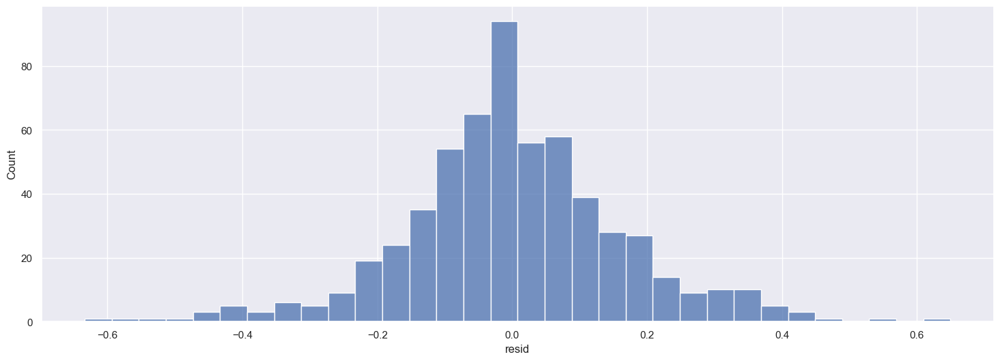

In [30]:
_, _ = plt.subplots(figsize = (18, 6))

sns.histplot(data=residual)

plt.show()

In conclusion, we can see that the residuals do not have patterns and follow (or at least almost follows) a normal distribution, this is a characteristic of white sounds which indicates that we got all the information from the time series.

## Correlation

Autocorrelation is the correlation of a time series with a lagged copy of itself. This chart helps us see if values in the time series are correlated with previous values.

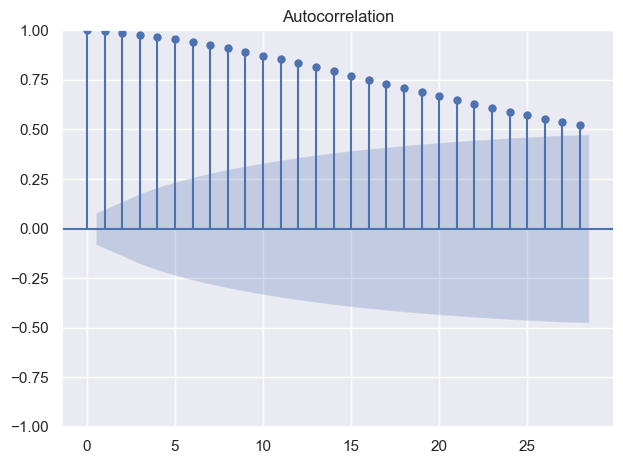

In [31]:
from statsmodels.graphics.tsaplots import plot_acf


plot_acf(ts)

plt.tight_layout()
plt.show()

With the autocorrelation chart, we can see that the time series is correlated with previous values positively. This means that values depends on previous values and while they grow the next values will grow too.

# Data set up

Set up the data to train the model

In [32]:
from sklearn.model_selection import TimeSeriesSplit

N_SPLITS = 3

X = df['date']
y = df['depth_to_groundwater']

folds = TimeSeriesSplit(n_splits=N_SPLITS)

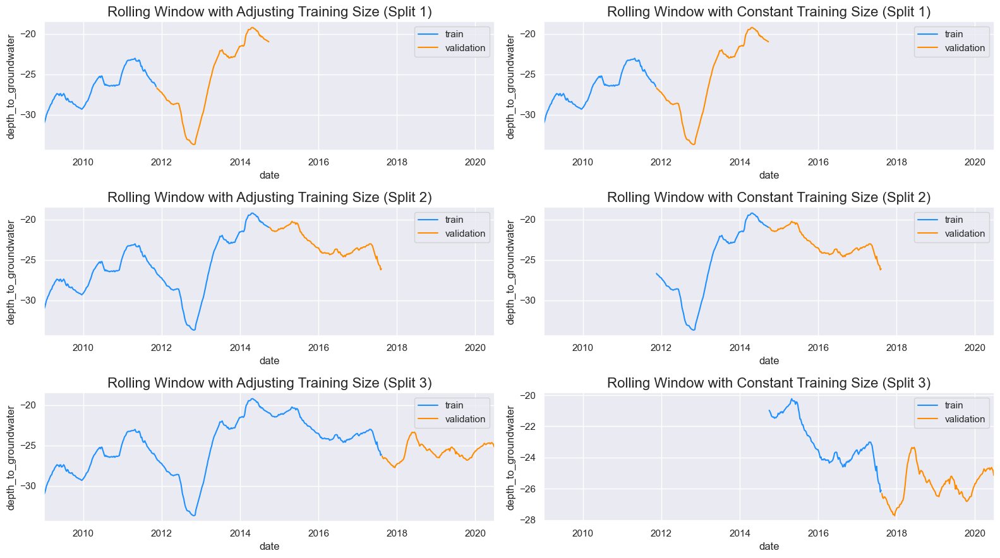

In [33]:
f, ax = plt.subplots(nrows=N_SPLITS, ncols=2, figsize=(16, 9))

for i, (train_index, valid_index) in enumerate(folds.split(X)):
    X_train, X_valid = X[train_index], X[valid_index]
    y_train, y_valid = y[train_index], y[valid_index]

    sns.lineplot(
        x=X_train,
        y=y_train,
        ax=ax[i,0],
        color='dodgerblue',
        label='train'
    )
    sns.lineplot(
        x=X_train[len(X_train) - len(X_valid):(len(X_train) - len(X_valid) + len(X_valid))],
        y=y_train[len(X_train) - len(X_valid):(len(X_train) - len(X_valid) + len(X_valid))],
        ax=ax[i,1],
        color='dodgerblue',
        label='train'
    )

    for j in range(2):
        sns.lineplot(x= X_valid, y= y_valid, ax=ax[i, j], color='darkorange', label='validation')
    ax[i, 0].set_title(f"Rolling Window with Adjusting Training Size (Split {i+1})", fontsize=16)
    ax[i, 1].set_title(f"Rolling Window with Constant Training Size (Split {i+1})", fontsize=16)

for i in range(N_SPLITS):
    ax[i, 0].set_xlim([date(2009, 1, 1), date(2020, 6, 30)])
    ax[i, 1].set_xlim([date(2009, 1, 1), date(2020, 6, 30)])

plt.tight_layout()
plt.show()

Seen what could be done with the time series for training and testing we now create our train and test splits.

In [34]:
train_size = int(0.85 * len(df))
test_size = len(df) - train_size

univariate_df = df[['date', 'depth_to_groundwater']].copy()
univariate_df.columns = ['ds', 'y']

train = univariate_df.iloc[:train_size, :]

x_train, y_train = pd.DataFrame(univariate_df.iloc[:train_size, 0]), pd.DataFrame(univariate_df.iloc[:train_size, 1])
x_test, y_test = pd.DataFrame(univariate_df.iloc[train_size:, 0]), pd.DataFrame(univariate_df.iloc[train_size:, 1])

print(f'Train size: {len(train)}')
print(f'Test size: {len(x_test)}')

Train size: 510
Test size: 90


# AUTO ARIMA model

## Create the model

In [35]:
from pmdarima import auto_arima

model = auto_arima(
    y_train,
    start_p=1,
    start_q=1,
    test='adf',       # use adftest to find optimal 'd'
    max_p=3, max_q=3, # maximum p and q
    m=1,              # frequency of series
    d=None,           # let model determine 'd'
    seasonal=False,   # No Seasonality
    start_P=0,
    D=0,
    trace=True,
    error_action='ignore',
    suppress_warnings=True,
    stepwise=True
)

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will 

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=-631.136, Time=0.20 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=-242.692, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=-574.047, Time=0.15 sec


F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=-427.347, Time=0.09 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=-243.054, Time=0.03 sec


F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=-629.209, Time=0.47 sec


F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=-629.237, Time=0.32 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=-492.779, Time=0.14 sec


F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=-611.065, Time=0.14 sec


F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=-628.351, Time=0.49 sec
 ARIMA(1,1,1)(0,0,0)[0]             : AIC=-632.995, Time=0.08 sec
 ARIMA(0,1,1)(0,0,0)[0]             : AIC=-428.258, Time=0.05 sec
 ARIMA(1,1,0)(0,0,0)[0]             : AIC=-575.735, Time=0.04 sec


F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



 ARIMA(2,1,1)(0,0,0)[0]             : AIC=-631.069, Time=0.18 sec
 ARIMA(1,1,2)(0,0,0)[0]             : AIC=-631.097, Time=0.14 sec
 ARIMA(0,1,2)(0,0,0)[0]             : AIC=-494.001, Time=0.06 sec


F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



 ARIMA(2,1,0)(0,0,0)[0]             : AIC=-612.866, Time=0.06 sec


F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



 ARIMA(2,1,2)(0,0,0)[0]             : AIC=-630.210, Time=0.28 sec

Best model:  ARIMA(1,1,1)(0,0,0)[0]          
Total fit time: 2.970 seconds


In [36]:
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                  510
Model:               SARIMAX(1, 1, 1)   Log Likelihood                 319.497
Date:                Sun, 08 Jun 2025   AIC                           -632.995
Time:                        21:31:55   BIC                           -620.297
Sample:                             0   HQIC                          -628.016
                                - 510                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9195      0.021     43.764      0.000       0.878       0.961
ma.L1         -0.4885      0.037    -13.357      0.000      -0.560      -0.417
sigma2         0.0167      0.001     24.809      0.000       0.015       0.018
===================================================================================
Ljung-Box (L1) (Q):                   0.02   Jarque-Bera (JB):               185.01
Prob(Q):                              0.90   Prob(JB):                         0.00
Heteroskedasticity (H):               1.17   Skew:                             0.22
Prob(H) (two-sided):                  0.32   Kurtosis:                         5.92
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

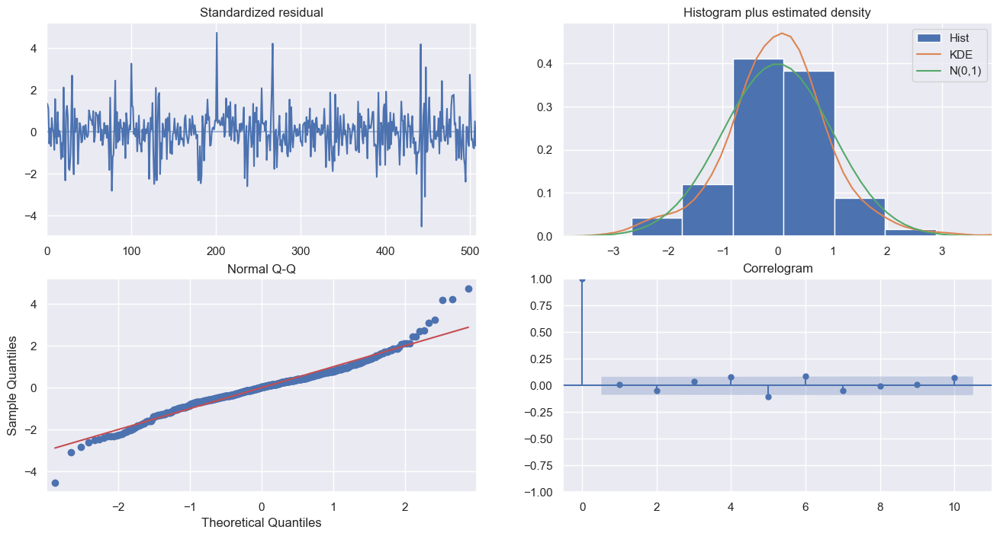

In [37]:
model.plot_diagnostics(figsize=(16,8))
plt.show()

So how to interpret the plot diagnostics?

- **Top left**: The residual errors seem to fluctuate around a mean of zero and have a uniform variance.
- **Top Right**: The density plot suggests normal distribution with a mean of zero.
- **Bottom left**: We can see the same number of dots under and over the line.
- **Bottom Right**: The Correlogram, aka, ACF plot shows the residual errors are not autocorrelated.

## Model predictions

In [38]:
forecast_length = len(x_test['ds'])

# make the prediction
forecast = model.predict(forecast_length)
# set the series index and values
forecast.index = x_test['ds']
forecast

F:\SoftwareInstalls\Anaconda\envs\time-series\Lib\site-packages\sklearn\utils\deprecation.py:151: FutureWarning:

'force_all_finite' was renamed to 'ensure_all_finite' in 1.6 and will be removed in 1.8.



ds
2018-10-11   -25.687034
2018-10-18   -25.802534
2018-10-25   -25.908742
2018-11-01   -26.006405
2018-11-08   -26.096211
                ...    
2020-05-28   -27.121506
2020-06-04   -27.121598
2020-06-11   -27.121683
2020-06-18   -27.121761
2020-06-25   -27.121833
Length: 90, dtype: float64

Create the train time series to see the graph and performance of the model.

In [39]:
ts_train = y_train['y']
ts_train.index = x_train['ds']
ts_train

ds
2009-01-01   -31.048571
2009-01-08   -30.784286
2009-01-15   -30.420000
2009-01-22   -30.018571
2009-01-29   -29.790000
                ...    
2018-09-06   -25.030000
2018-09-13   -25.194286
2018-09-20   -25.230000
2018-09-27   -25.378571
2018-10-04   -25.561429
Name: y, Length: 510, dtype: float64

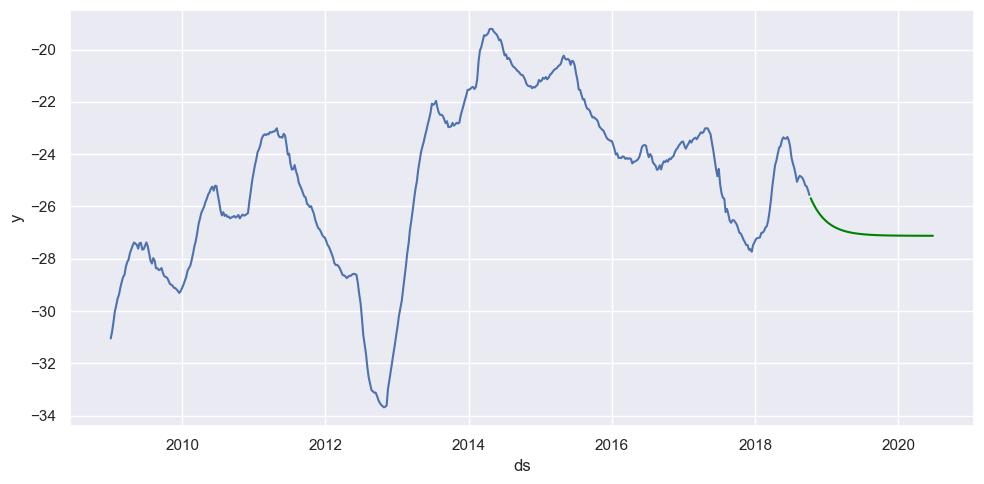

In [40]:
import matplotlib.pyplot as plt

fig, axis = plt.subplots(figsize = (10, 5))

sns.lineplot(data=ts_train)
sns.lineplot(data=forecast, c="green")

plt.tight_layout()

plt.show()

In [41]:
import plotly.graph_objects as go


# graph the original and the predictions
fig = go.Figure()
# original series
fig.add_trace(go.Scatter(x=ts_train.index, y=ts_train, name="Stationary series"))
# predictions
fig.add_trace(go.Scatter(x=forecast.index, y=forecast, name="Prediction", line=dict(color="green")))

fig.update_layout(title="Predictions", xaxis_title="Dates", yaxis_title="Depth")
fig.show()

## Metrics

Lets verify the performance of the model with the MSE

In [42]:
import math
from sklearn.metrics import mean_absolute_error, mean_squared_error


# calculate metrics
score_mae = mean_absolute_error(y_test, forecast)
score_rmse = math.sqrt(mean_squared_error(y_test, forecast))

print('RMSE: {}'.format(score_rmse))

RMSE: 1.4025269585251297


The RMSE is close to 0 so we can conclude that the model has an ok performance.

# Conclusion

We can see that this way we can have a model with acceptable performance. In the future, it is recommended to use models that allow for multi-regression (multiple results as output) to predict all the values ​​needed and established in the problem, as well as having multiple variables to obtain better results based not only on a single feature.

## Save the model

In [43]:
from pickle import dump

model_dile_name = '../models/model.sav'

with open(model_dile_name, "wb") as file:
    dump(model, file)